In [1]:
import pickle, os
from matplotlib import pyplot as plt
from hal import HAL  # this imports the class HAL() 
from sklearn.datasets import make_blobs
from hal import metric
import numpy as np
import pickle, os
from matplotlib.colors import ListedColormap

/home/tonny/anaconda3/envs/reckless/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/tonny/anaconda3/envs/reckless/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/tonny/anaconda3/envs/reckless/lib/python3.8/site-packages/umap/d

### benchmarking on lupus

In [2]:

import pandas as pd
df = pd.read_pickle('lupus_singlecell_with_clinical.pkl')

In [3]:
df.head()

,CD45,CD196_CCR6,CD181_CXCR1,HLA_DR,CD15,CD31_PECAM1,CD8a,CD182_CXCR2,IgA,CD66ace,...,CD278_ICOS,CD32,CD152_CTLA4,IgM,CD184_CXCR4,CD279_PD1,CD56,CD16,Label,score
0,-0.356992,-0.788635,0.469173,0.930344,1.148234,0.248946,-0.045911,0.839462,0.974499,0.760940,...,2.349232,0.489144,-0.444082,-0.752690,-0.673722,1.910522,-0.317744,-0.013210,65,1
3,0.755822,0.641979,1.297847,1.286800,1.462421,1.277938,1.089990,0.976031,1.279445,0.727344,...,1.428635,0.275005,0.701059,-0.302479,1.252277,-0.216829,-0.317744,0.626230,65,1
5,-1.426300,-0.534716,0.727163,0.591198,-0.322403,-0.503724,1.562422,0.686070,0.496856,-0.824600,...,-0.469382,0.112633,-0.444082,-0.752690,0.117495,-0.783629,-0.317744,0.986129,139,1
6,1.664673,1.399350,0.756659,1.089111,0.426199,1.242852,1.437677,0.514643,1.170881,-0.418303,...,-0.469382,1.041804,0.253240,-0.752690,1.632619,-0.783629,-0.317744,-2.843229,29,1
7,1.221746,-0.276112,0.646495,0.636921,-0.289052,-1.548800,-0.799183,0.168634,-0.459735,0.402275,...,-0.469382,0.783679,-0.444082,-0.752690,1.901195,-0.783629,-0.317744,0.465178,88,1


In [4]:
lupus_model = pickle.load(open('./lupus_model_fin/'+"hal_e7e81c4e438a8daab900219827361f1897b6dc99.pkl",'rb'))[1]
X_embed = pickle.load(open('./lupus_model_fin/'+"tsne_5ffc480c6ce29c9fef042942125348dade62548c.pkl",'rb'))

/home/tonny/anaconda3/envs/reckless/lib/python3.8/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator RobustScaler from version 1.0.2 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
/home/tonny/anaconda3/envs/reckless/lib/python3.8/site-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator SVC from version 1.0.2 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [5]:
Y_init = lupus_model.tree.y_pred_init

In [6]:
KNN = pickle.load(open('./lupus_model_fin/'+"kNN_e81cbede97a6db54e7d6d9e73eb61dc5c4abb19b.pkl",'rb'))

In [7]:

def get_ypred_from_merge(merge, previous_ypred):
    new_ypred  = []
    combine = merge[0]
    into = merge[1]
    score = round(merge[2].cv_score, 3)
    
    for i in range(len(previous_ypred)):
        if previous_ypred[i] in combine:
            new_ypred.append(into)
        else:
            new_ypred.append(previous_ypred[i])
            
    return new_ypred, score

In [8]:
def transform_list(input_list):
    unique_values = sorted(set(input_list))
    mapping = {val: index - 1 for index, val in enumerate(unique_values)}
    transformed_list = [mapping[val] for val in input_list]
    return transformed_list

In [9]:
y_history = {}
y_history_normalized = {}

def iter_history(merg_history, previous, score, count):
    y_history[count] = {'score': score, 'y_pred': previous}
    y_history_normalized[count] = {'score': score, 'y_pred': transform_list(previous)}
    
    if len(merg_history) == count:
        y_history
    else:
        pred_new, new_score = get_ypred_from_merge(merg_history[count], previous)
        iter_history(merg_history, pred_new, new_score, (count + 1))



In [10]:
iter_history(KNN.merger_history, Y_init, 0, 0)

In [11]:
def get_from_cv(pred_his, cv):
    for i in range(len(pred_his)):
        if pred_his[i]['score'] >= cv:
            return pred_his[i - 1]['y_pred']
    return pred_his[-1]

In [12]:
pred = get_from_cv(y_history_normalized, 0.899)

In [13]:
def display_all(pred_his):
    for i in range(len(pred_his)):
        y_pred = pred_his[i]['y_pred']
        cv_score = pred_his[i]['score']
        plot_pred(y_pred, cv_score)
        
    

In [16]:

from matplotlib import pyplot as plt

def plot_pred(y_pred, cv_score):

    # Extract X and Y coordinates from X
    X_coordinates = [coord[0] for coord in X_embed]
    Y_coordinates = [coord[1] for coord in X_embed]

    # Set figure size
    plt.figure(figsize=(10, 8))

    # Get unique values in Y
    unique_values = sorted(list(set(y_pred)))
    num_unique = len(y_pred)

    # Create a custom colormap with a distinct color for each unique value
    colors = plt.cm.get_cmap('tab20', num_unique)  # Choose a colormap (e.g., 'tab20')
    custom_cmap = ListedColormap([colors(i) for i in range(num_unique)])

    # Create scatter plot with larger marker size and color based on the mapping
    plt.scatter(X_coordinates, Y_coordinates, c=y_pred, cmap=custom_cmap, s=0.5)

    # Add colorbar for the colormap
    cbar = plt.colorbar()
    cbar.set_label('Y Values')

    # Add labels and title
    plt.xlabel('X Coordinate')
    plt.ylabel('Y Coordinate')
    plt.title(f'Predicted Clusters for cv: {cv_score}  , n_clusters: {len(np.unique(y_pred)) - 1}')
    
    #saveplot
    plt.savefig(f'./viz/lupus_cv_{cv_score}.svg', format='svg', dpi=1200)
    
    # Show the plot
    plt.show()

/tmp/ipykernel_15751/3606709359.py:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab20', num_unique)  # Choose a colormap (e.g., 'tab20')


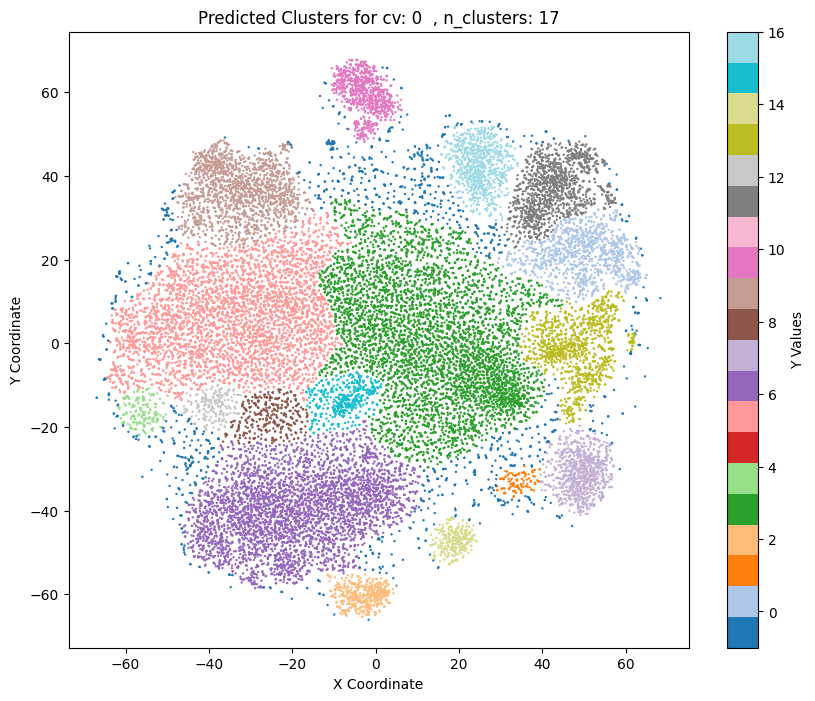

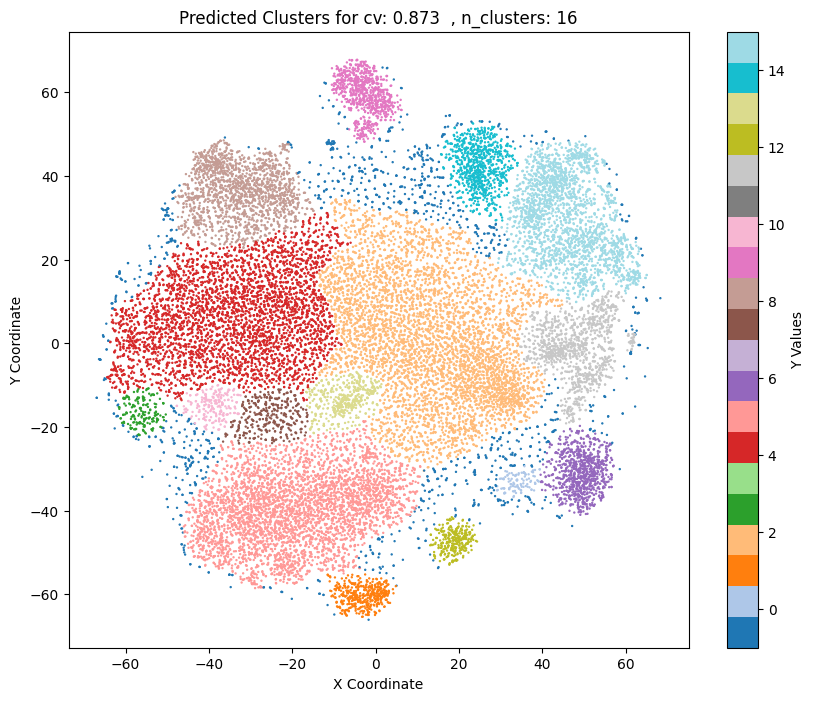

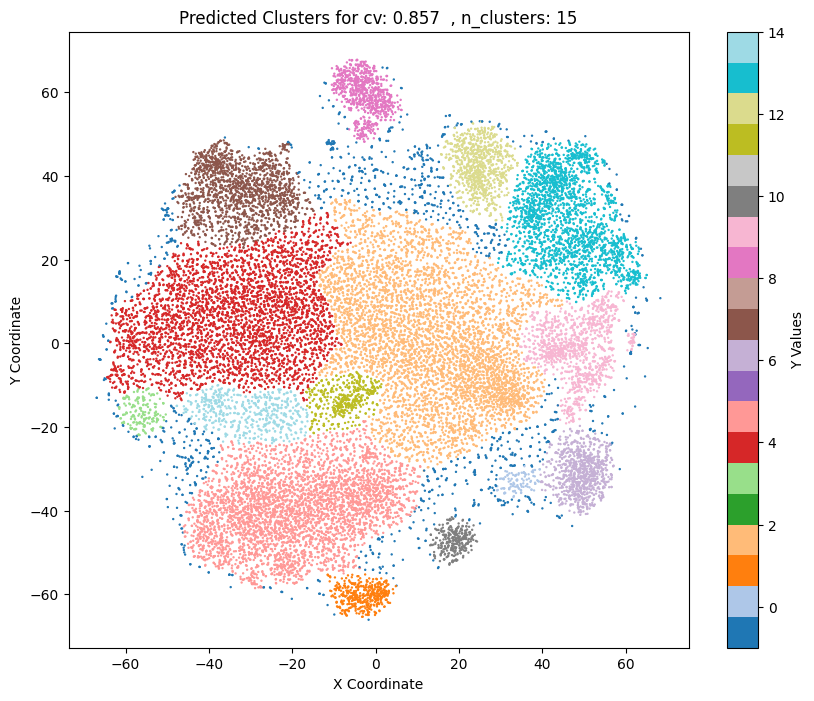

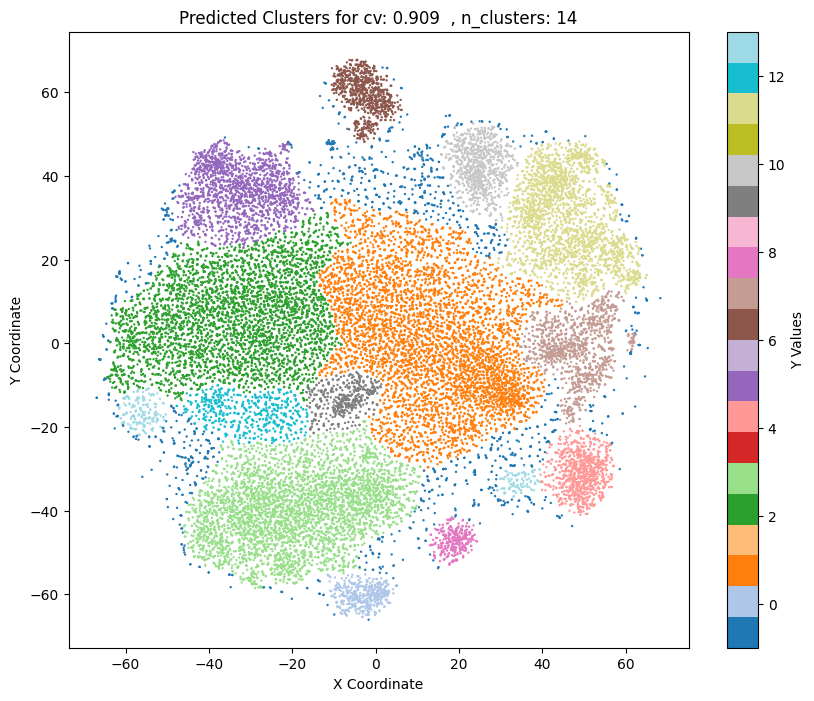

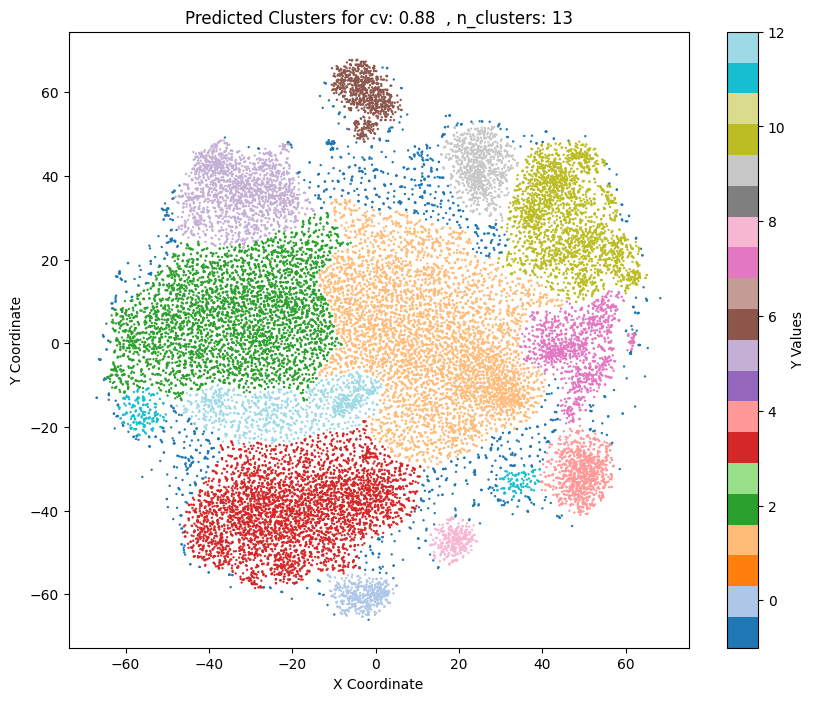

...

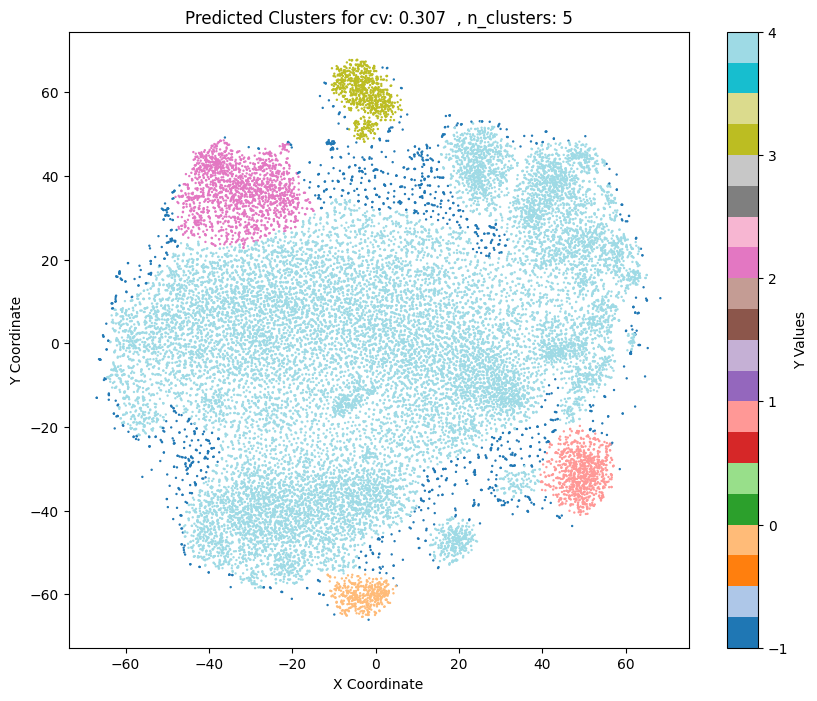

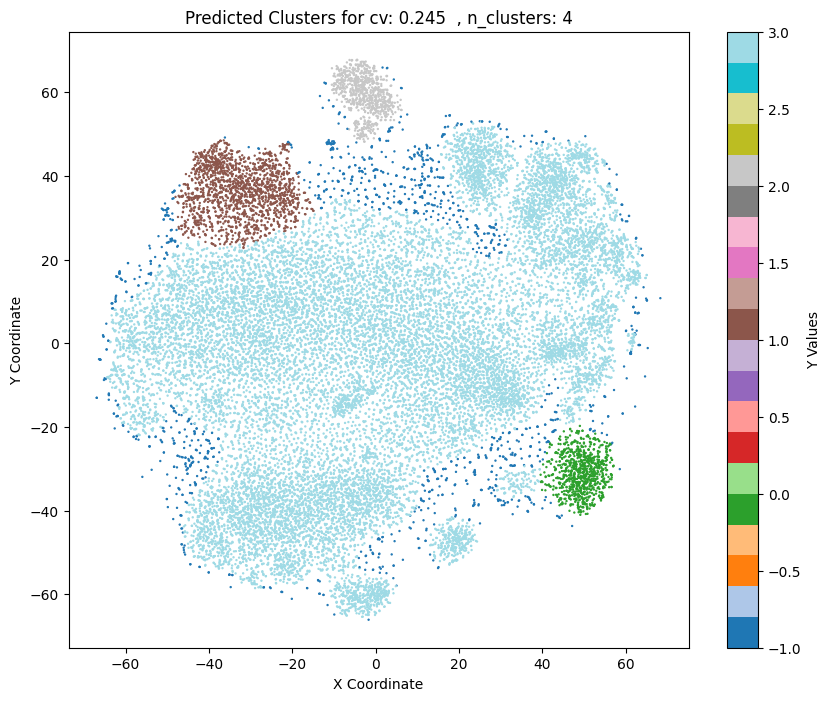

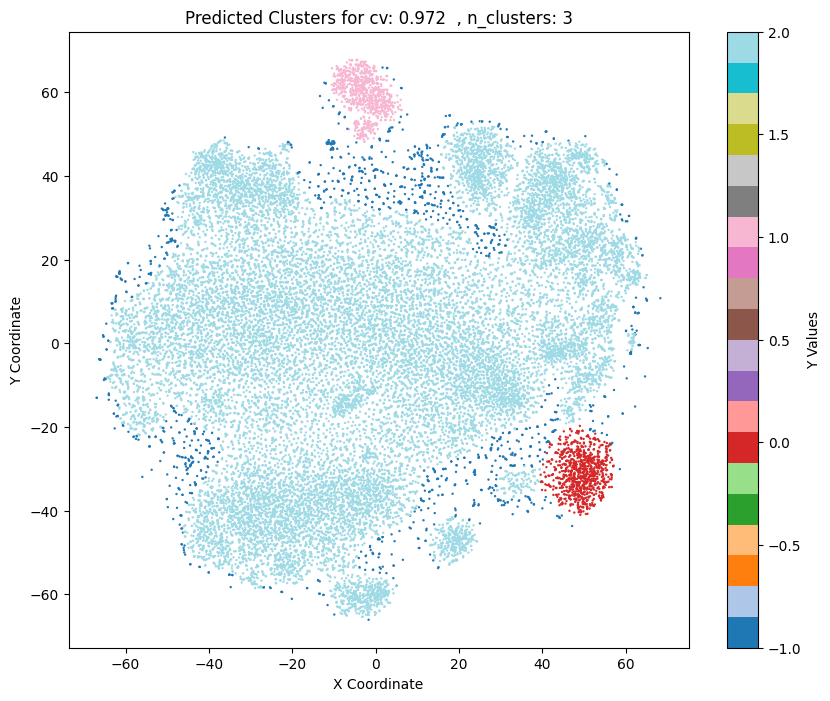

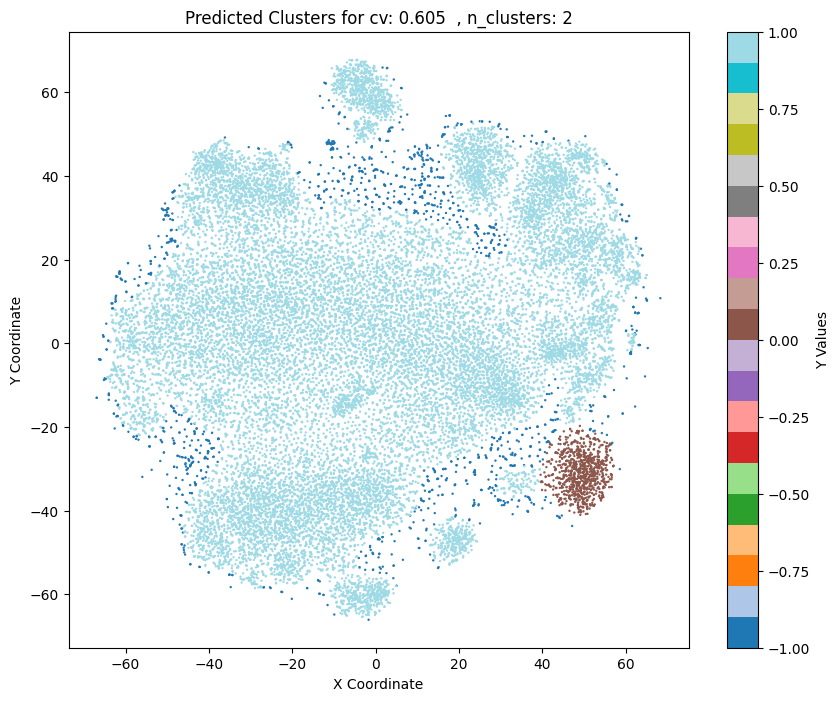

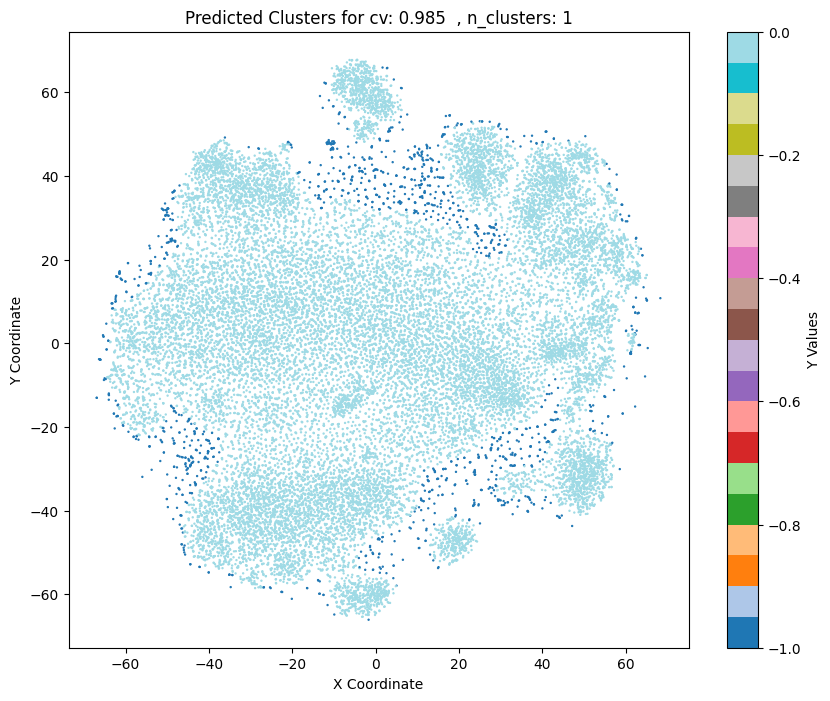

In [17]:
display_all(y_history_normalized)

## Benchmarking on synthetic datasets

In [14]:
import time
from sklearn.model_selection import train_test_split
from hal import HAL  # this imports the class HAL() 
from sklearn.datasets import make_blobs
from hal import metric
import numpy as np
import pickle, os

In [2]:


def exec_hal(model, data, data_train):
    start = time.time()
    
    model.fit(data_train)
    ypred50 = model.predict(data, cv=0.5)
    
    end = time.time()
    
    entry = {'model': model, 'n_objects': len(data), 'exec_time': end - start}
    
    return entry
 
    
benchmark = {}    
    

#### Benchmarking 10^3

In [3]:

X,ytrue = make_blobs(n_samples=1000,n_features=30) 
data_train, data_test, labels_train, labels_test = train_test_split(X, ytrue, test_size=200, random_state=42)

model = HAL(clf_type='svm', warm_start=False, root="size_10^3") # 

benchmark[1] = exec_hal(model, X, data_test) #use downsampled part

# create a binary pickle file 
f = open("performance.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(benchmark,f)

# close file
f.close()

Preprocessing data, whiten = False, zscore = True
[pipeline.py]    Running t-SNE for X.shape = (200,30)
Will use momentum during exaggeration phase
Computing input similarities...
Using perplexity, so normalizing input data (to prevent numerical problems)
Using perplexity, not the manually set kernel width.  K (number of nearest neighbors) and sigma (bandwidth) parameters are going to be ignored.
Using ANNOY for knn search, with parameters: n_trees 50 and search_k 7500
Going to allocate memory. N: 200, K: 150, N*K = 30000
Building Annoy tree...
Done building tree. Beginning nearest neighbor search... 
parallel (8 threads):
[HAL]    t-SNE data saved in tsne_5ffc480c6ce29c9fef042942125348dade62548c.pkl
[HAL] density_model       :   <fdc.fdc.FDC object at 0x7f1a5b93d3d0>
[HAL] outlier_ratio       :   0.05                
[HAL] nn_pure_ratio       :   0.0                 
[HAL] y_murky             :   None                
[HAL] min_size_cluster    :   50                  
[HAL] y          

[graph] 0 -- 2              1.0000       +/-    0.0000    
[graph] 1 -- 2              1.0000       +/-    0.0000    
Merging edge	 [0, 1, 2] 	 gap= 0.0 	 score= [1.0, 1.0]



Building tree
3
Preprocessing with same methods as during training	 {'whiten': False, 'zscore': True}
-> Predicting on 10000 points
Preprocessing data, whiten = False, zscore = True
[pipeline.py]    Running t-SNE for X.shape = (1000,30)

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input similarities computed (sparsity = 0.859050)!
Learning embedding...
Using FIt-SNE approximation.
Iteration 50 (50 iterations in 0.38 seconds), cost 0.471831
Iteration 100 (50 iterations in 0.51 seconds), cost 0.388860
Iteration 150 (50 iterations in 0.46 seconds), cost 0.349718
Iteration 200 (50 iterations in 0.44 seconds), cost 0.322143
Iteration 250 (50 iterations in 0.45 seconds), cost 0.393005
Unexaggerating Ps by 12.000000
Iteration 300 (50 iterations in 0.43 seconds), cost 0.198338
Iteration 3

[graph] 0 -- 2              1.0000       +/-    0.0000    
[graph] 1 -- 2              1.0000       +/-    0.0000    
Merging edge	 [0, 1, 2] 	 gap= 0.0 	 score= [1.0, 1.0]



Building tree
3
Preprocessing with same methods as during training	 {'whiten': False, 'zscore': True}
-> Predicting on 100000 points
Preprocessing data, whiten = False, zscore = True
[pipeline.py]    Running t-SNE for X.shape = (10000,30)

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input similarities computed (sparsity = 0.194154)!
Learning embedding...
Using FIt-SNE approximation.
Iteration 50 (50 iterations in 0.40 seconds), cost 1.903061
Iteration 100 (50 iterations in 0.45 seconds), cost 1.792136
Iteration 150 (50 iterations in 0.42 seconds), cost 1.768987
Iteration 200 (50 iterations in 0.37 seconds), cost 1.737952
Iteration 250 (50 iterations in 0.40 seconds), cost 1.736137
Unexaggerating Ps by 12.000000
Iteration 300 (50 iterations in 0.40 seconds), cost 1.500688
Iteration

[kde] Minimum bound = 0.0037 	 Rough estimate of h = 0.0368 	 Maximum bound = 0.7218
[kde] Bandwidth tolerance (xtol) set to precision of minimum bound : 0.00100 
[kde] Found log-likelihood maximum in 12 evaluations, h = 0.14398
[fdc] Computing density with 1 thread...
[fdc] Finding centers ...
[fdc] Found 3 potential centers ...
[fdc] Merging overlapping minimal clusters ...
      # of stable clusters with noise 0.000000 : 3
[fdc] Done in 5.987 s
[fdc] Coarse graining until desired noise threshold ...
[fdc.py]    Reached number of specified clusters [= 20] (or close to), n_cluster = 3
[purify.py]    # of clusters after purification : 3
 label  count  ratio
    -1    500 0.0500
     0   3168 0.3168
     1   3186 0.3186
     2   3146 0.3146
kNN-graph options: {'n_bootstrap': 30, 'test_size_ratio': 0.8, 'clf_type': 'svm', 'n_sample_max': 500, 'recomputed': False, 'clf_args': {'kernel': 'linear', 'class_weight': 'balanced'}, 'fout': None, 'n_edge': 4, 'gap_min': 0.01, 'gap_option': 'stand

<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinica

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ith_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_sing

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clini

<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinica

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



cal.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_wi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pk

<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinica

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



redReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



me='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedR

<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinica

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



er name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.Buff

<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinica

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'

<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinica

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.BufferedReader name='lupus_singlecell_with_clinical.pkl'>
<_io.Bu

<class 'pandas.core.frame.DataFrame'>
Index: 25901568 entries, 0 to 299998
Data columns (total 36 columns):
 #   Column           Dtype  
---  ------           -----  
 0   CD45             float32
 1   CD196_CCR6       float32
 2   CD181_CXCR1      float32
 3   HLA_DR           float32
 4   CD15             float32
 5   CD31_PECAM1      float32
 6   CD8a             float32
 7   CD182_CXCR2      float32
 8   IgA              float32
 9   CD66ace          float32
 10  CD63             float32
 11  CD14             float32
 12  CD66b            float32
 13  CD62L_Lselectin  float32
 14  CD3              float32
 15  CD27             float32
 16  CD86             float32
 17  CD10             float32
 18  CD197_CCR7       float32
 19  CD28             float32
 20  CD11c            float32
 21  CD33             float32
 22  CD161            float32
 23  CD45RO           float32
 24  CD24             float32
 25  CD38             float32
 26  CD278_ICOS       float32
 27  CD32             

#### Benchmarking 10^4

In [4]:
#centers=10,  cluster_std=6

X,ytrue = make_blobs(n_samples=10000,n_features=30) 
data_train, data_test, labels_train, labels_test = train_test_split(X, ytrue, test_size=0.02, random_state=42)
model = HAL(clf_type='svm', warm_start=False, root="size_10^4") # 

benchmark[2] = exec_hal(model, X, data_test) #use downsampled part

# create a binary pickle file 
f = open("performance.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(benchmark,f)

# close file
f.close()

#### Benchmarking 10^5

In [5]:

X,ytrue = make_blobs(n_samples=100000,n_features=30) 
data_train, data_test, labels_train, labels_test= train_test_split(X, ytrue, test_size=0.01, random_state=42)
model = HAL(clf_type='svm', warm_start=False, root="size_10^5") # 

benchmark[3] = exec_hal(model, X, data_test) #use downsampled part

# create a binary pickle file 
f = open("performance.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(benchmark,f)

# close file
f.close()

#### Benchmarking 10^6

In [6]:

X,ytrue = make_blobs(n_samples=1000000,n_features=30) 
data_train, data_test, labels_train, labels_test = train_test_split(X, ytrue, test_size=0.01, random_state=42)
model = HAL(clf_type='svm', warm_start=False, root="size_10^6") # 

benchmark[4] = exec_hal(model, X, data_test) #use downsampled part

# create a binary pickle file 
f = open("performance.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(benchmark,f)

# close file
f.close()

#### Benchmarking 10^7

In [7]:

X,ytrue = make_blobs(n_samples=10000000,n_features=30) 
data_train, data_test, labels_train, labels_test = train_test_split(X, ytrue, test_size=0.001, random_state=42)
model = HAL(clf_type='svm', warm_start=False, root="size_10^7") # 

benchmark[5] = exec_hal(model, X, data_test) #use downsampled part

# create a binary pickle file 
f = open("performance.pkl","wb")

# write the python object (dict) to pickle file
pickle.dump(benchmark,f)

# close file
f.close()

In [8]:
with open('performance.pkl', 'rb') as handle:
    performance_dic = pickle.load(handle)
    
print(performance_dic)

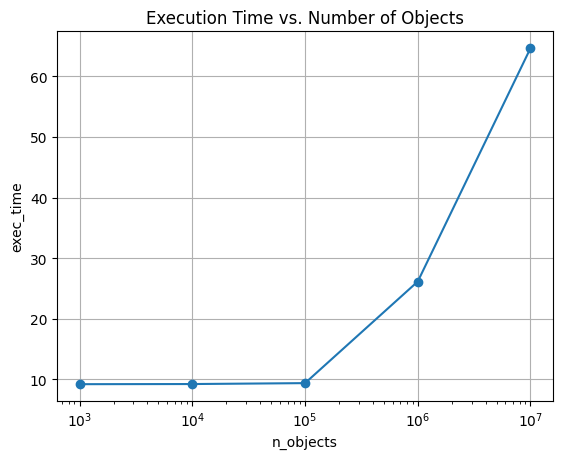

In [9]:
import matplotlib.pyplot as plt
x = []
y = []

for key, value in performance_dic.items():
    x.append(value['n_objects'])
    y.append(value['exec_time'])

plt.semilogx(x, y, marker='o')
plt.xlabel('n_objects')
plt.ylabel('exec_time')
plt.title('Execution Time vs. Number of Objects')
plt.grid(True)
plt.show()